In [1]:
import sys
sys.path.append('../../../')  
sys.path.append('../../../model')

from custom_loss_functions import psnr

from tensorflow.keras.models import load_model
from hformer_model import get_hformer_model, PatchExtractor
from skimage.metrics import structural_similarity as ssim

from skimage.util import view_as_blocks

import numpy as np

from skimage.metrics import peak_signal_noise_ratio

import tensorflow as tf
from tensorflow import keras
from keras import layers, models
from keras import backend as K

from sklearn.model_selection import train_test_split

from data_importer import load_testing_images
from data_importer import load_training_images, denormalize, trunc

import matplotlib.pyplot as plt


In [2]:
# Common testing image pairs (used to evaluate all models)

noisy_images, ground_truth_images = load_training_images('../../../../../../../../Dataset/LowDoseCTGrandChallenge/Training_Image_Data', load_limited_images=True, num_images_to_load=10)

_n, _g = load_training_images('../../../../../../../../Dataset/LowDoseCTGrandChallenge/Selected_Image_Pairs/', load_limited_images=False)
noisy_images = np.concatenate((noisy_images, _n), axis=0)
ground_truth_images = np.concatenate((ground_truth_images, _g), axis=0)
 
patch_extractor = PatchExtractor(patch_size=64, stride=64, name="patch_extractor")
test_image_patches = patch_extractor(noisy_images)

loaded training images x and y of len :  10 10  respectively
type of train images x :  float64
range of values in train images :  0.0 0.576171875
type of train images y :  float64
loaded training images x and y of len :  4 4  respectively
type of train images x :  float64
range of values in train images :  0.0 0.915283203125
type of train images y :  float64


In [3]:
test_images_with_no_ground_truth = load_testing_images('../../../../../../../../Dataset/LowDoseCTGrandChallenge/Testing_Image_Data', load_limited_images=True, num_images_to_load=5)
test_image_with_no_gt_patches = patch_extractor(test_images_with_no_ground_truth)

loaded testing images x of len :  5
type of test images x :  float64
range of values in test images :  0.0 0.619140625


Code for evaluation of model(s)

In [4]:
def view_model_history(history, psnr_or_accuracy):
    # Visualize model history.
    #print('history keys : ', history.keys())

    # Plot loss, accuracy, val_loss and val_accuracy

    # Get the number of epochs
    num_epochs = len(history['loss'])

    # Plot training and validation accuracy / PSNR values
    if psnr_or_accuracy == 'accuracy':
        plt.figure(figsize=(12, 4))
        plt.subplot(1, 2, 1)
        plt.plot(range(1, num_epochs + 1), history['accuracy'], label='Training Accuracy')
        plt.plot(range(1, num_epochs + 1), history['val_accuracy'], label='Validation Accuracy')
        plt.title('Training and Validation Accuracy')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.legend()
    elif psnr_or_accuracy == 'psnr':
        plt.figure(figsize=(12, 4))
        plt.subplot(1, 2, 1)
        plt.plot(range(1, num_epochs + 1), history['psnr'], label='Training psnr')
        plt.plot(range(1, num_epochs + 1), history['val_psnr'], label='Validation psnr')
        plt.title('Training and Validation Psnr')
        plt.xlabel('Epoch')
        plt.ylabel('Psnr')
        plt.legend()
    elif psnr_or_accuracy == 'psnr_and_accuracy':
        plt.figure(figsize=(12, 4))
        plt.subplot(1, 2, 1)
        plt.plot(range(1, num_epochs + 1), history['psnr'], label='Training psnr')
        plt.plot(range(1, num_epochs + 1), history['val_psnr'], label='Validation psnr')
        plt.title('Training and Validation Psnr')
        plt.xlabel('Epoch')
        plt.ylabel('Psnr')
        plt.legend()
        
        plt.figure(figsize=(12, 4))
        plt.subplot(1, 2, 1)
        plt.plot(range(1, num_epochs + 1), history['accuracy'], label='Training Accuracy')
        plt.plot(range(1, num_epochs + 1), history['val_accuracy'], label='Validation Accuracy')
        plt.title('Training and Validation Accuracy')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.legend()
        
    # Plot training and validation loss values
    plt.subplot(1, 2, 2)
    plt.plot(range(1, num_epochs + 1), history['loss'], label='Training Loss')
    plt.plot(range(1, num_epochs + 1), history['val_loss'], label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    
    plt.tight_layout()
    plt.show()

In [5]:
def reconstruct_image_from_patches(patches, num_patches_per_row):
    patch_size = patches.shape[1]  # Assuming square patches
    num_patches = patches.shape[0]

    # Calculate the number of rows
    num_patches_per_col = num_patches // num_patches_per_row

    # Initialize an empty image to store the reconstructed result
    reconstructed_image = np.zeros((num_patches_per_col * patch_size, num_patches_per_row * patch_size))

    # Reshape the patches into a 2D array
    patches_2d = patches.reshape((num_patches_per_col, num_patches_per_row, patch_size, patch_size))

    # Reconstruct the image by placing each patch in its corresponding position
    for i in range(num_patches_per_col):
        for j in range(num_patches_per_row):
            reconstructed_image[i * patch_size:(i + 1) * patch_size, j * patch_size:(j + 1) * patch_size] = patches_2d[i, j]

    return np.expand_dims(reconstructed_image, axis=-1)



In [6]:
sys.path.append('../../')
from metrics import compute_SSIM, compute_PSNR

def calculate_psnr(original_image, reconstructed_image):
    return compute_PSNR(original_image, reconstructed_image, 240+160.0)

    psnr_value = peak_signal_noise_ratio(original_image, reconstructed_image, data_range=240+160)
    return psnr_value

def calculate_ssim(original_image, reconstructed_image):    
    ssim_value = ssim(original_image.astype(np.float64), reconstructed_image.astype(np.float64), win_size=5,  channel_axis=2, data_range=240+160)
    return ssim_value



In [7]:
def visualize_patches(patches, noisy_images,  ground_truth_images, num_images):
    num_patches_per_image = int(patches.shape[0] / num_images)

    print('patches per image : ', num_patches_per_image)

    patches = patches.astype(np.float64)
    
    print('datatype of patches : ', patches.dtype)
    print('datatype of ground truth image : ', ground_truth_images[0].dtype)

    for i in range(num_images):
        print('this image has start patches : ', i * num_patches_per_image)
        image_patches = patches[i * num_patches_per_image:i * num_patches_per_image + num_patches_per_image]

        fig, axes = plt.subplots(1, 4, figsize=(30, 30))
        axes = axes.flatten()
        
        reconstruct_image = (trunc(denormalize((reconstruct_image_from_patches(image_patches, 8)))))
        _noisy_image = trunc(denormalize(noisy_images[i]))
        _clean_image = trunc(denormalize(ground_truth_images[i]))
        
        
        print('[Normalized Images (Range : 0.0 to 1.0)]')
        print('PSNR of reconsturcted image : ', calculate_psnr(ground_truth_images[i], reconstruct_image_from_patches(image_patches, 8)))
        print('PSNR of noisy image : ', calculate_psnr(ground_truth_images[i], noisy_images[i]))
        print('SSIM of noisy image : ', calculate_ssim(ground_truth_images[i], noisy_images[i]))
        print('SSIM of reconstructed image : ', calculate_ssim(ground_truth_images[i], reconstruct_image_from_patches(image_patches, 8)))
        
        print('range of reconstructed image : ', np.min(reconstruct_image), np.max(reconstruct_image))
        print('range of clean image : ', np.min(_clean_image), np.max(_clean_image))

        print('reconstruct_image shape : ', reconstruct_image.shape)
        print('noisy image shape : ', noisy_images[i].shape)
        
        axes[0].set_title('input image')
        axes[0].imshow(_noisy_image, cmap='gray', vmin=-160.0, vmax=240.0)
        axes[0].axis('off')
        
        axes[1].set_title('ground truth image')
        axes[1].imshow(_clean_image, cmap='gray', vmin=-160.0, vmax=240.0)
        axes[1].axis('off')
        
        axes[2].set_title('model prediction')
        axes[2].imshow((reconstruct_image), cmap='gray', vmin=-160.0, vmax=240.0)
        axes[2].axis('off')
        
        axes[3].set_title('removed noise')
        axes[3].imshow(trunc(_noisy_image - reconstruct_image), cmap='gray', vmin=-160.0, vmax=240.0)
        axes[3].axis('off')
        
        print('[After Denormalization]')
        print('PSNR of reconsturcted image : ', calculate_psnr(_clean_image, reconstruct_image))
        print('PSNR of noisy image : ', calculate_psnr(_clean_image, _noisy_image))
        print('SSIM of noisy image : ', calculate_ssim(_clean_image, _noisy_image))
        print('SSIM of reconstructed image : ', calculate_ssim(_clean_image, reconstruct_image))
        
        plt.show()


In [8]:
def visualize_patches_with_no_gt(patches, noisy_images, num_images):
    num_patches_per_image = int(patches.shape[0] / num_images)

    patches = patches.astype(np.float64)
    print('datatype of patches : ', patches.dtype)
    
    print('patches per image : ', num_patches_per_image)

    for i in range(num_images):
        print('this image has start patches : ', i * num_patches_per_image)
        image_patches = patches[i * num_patches_per_image:i * num_patches_per_image + num_patches_per_image]

        fig, axes = plt.subplots(1, 3, figsize=(28, 28))
        axes = axes.flatten()
        
        reconstruct_image = trunc(denormalize((reconstruct_image_from_patches(image_patches, 8))))
 
        print('range of reconstructed image : ', np.min(reconstruct_image), np.max(reconstruct_image))
        print('reconstruct_image shape : ', reconstruct_image.shape)
        print('noisy image shape : ', noisy_images[i].shape)
        
        noisy = trunc(denormalize(noisy_images[i]))
        
        axes[0].set_title('input image')
        axes[0].imshow(noisy, cmap='gray', vmin=-160.0, vmax=240.0)
        axes[0].axis('off')
                
        axes[1].set_title('model prediction')
        axes[1].imshow(reconstruct_image, cmap='gray', vmin=-160.0, vmax=240.0)
        axes[1].axis('off')
        
        axes[2].set_title('removed noise')
        axes[2].imshow((noisy - reconstruct_image), cmap='gray')
        axes[2].axis('off')

        print('PSNR of reconsturcted image : ', calculate_psnr(trunc(denormalize(ground_truth_images[i])), trunc(denormalize(reconstruct_image))))
        print('SSIM of reconstructed image : ', calculate_ssim(trunc(denormalize(ground_truth_images[i])), trunc(denormalize(reconstruct_image))))

        plt.show()


In [9]:
def evaluate_model(model, history, name, psnr_or_accuracy):
    print('Training history of model : ', name)
    view_model_history(history, psnr_or_accuracy)
    
    print('Model prediction test')
    
    predictions = model.predict(test_image_patches).astype(np.float64)
    visualize_patches(predictions, noisy_images, ground_truth_images, len(noisy_images))
    print('\n\n\n\n\n')
    
    print('Model prediction test on blind images')    
    predictions = model.predict(test_image_with_no_gt_patches).astype(np.float64)
    visualize_patches_with_no_gt(predictions, test_images_with_no_ground_truth, len(test_images_with_no_ground_truth))
    print('\n\n\n\n\n')
    

Test on partial (4000 image) dataset

Model: "hformer_model_extended_64_channel"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_projection_layer (Inp  multiple                 320       
 utProjectionLayer)                                              
                                                                 
 output_projection_layer (Ou  multiple                 257       
 tputProjectionLayer)                                            
                                                                 
 conv_net_block_1 (Convoluti  multiple                 36416     
 onBlock)                                                        
                                                                 
 conv_net_block_2 (Convoluti  multiple                 36416     
 onBlock)                                                        
                                                                 
 downsampling_layer_1 (Conv2  mul

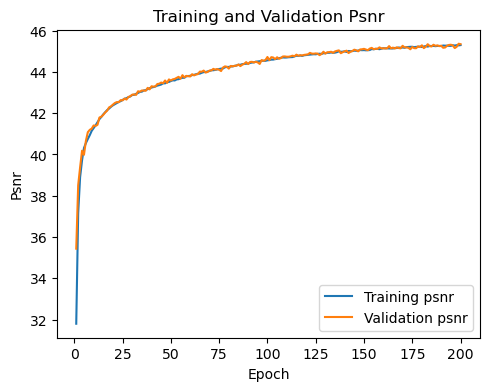

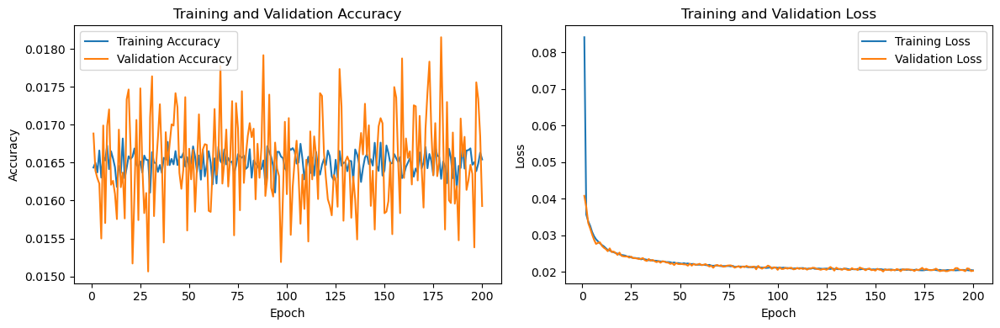

Model prediction test
28/28 [==============================] - 13s 127ms/step
patches per image :  64
datatype of patches :  float64
datatype of ground truth image :  float64
this image has start patches :  0
[Normalized Images (Range : 0.0 to 1.0)]
PSNR of reconsturcted image :  96.00220525660399
PSNR of noisy image :  91.98294812873738
SSIM of noisy image :  0.9999985095433271
SSIM of reconstructed image :  0.9999992949951726
range of reconstructed image :  -160.0 240.0
range of clean image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
[After Denormalization]
PSNR of reconsturcted image :  27.787145549659282
PSNR of noisy image :  23.485824280503806
SSIM of noisy image :  0.8237903225027777
SSIM of reconstructed image :  0.8605790313283406


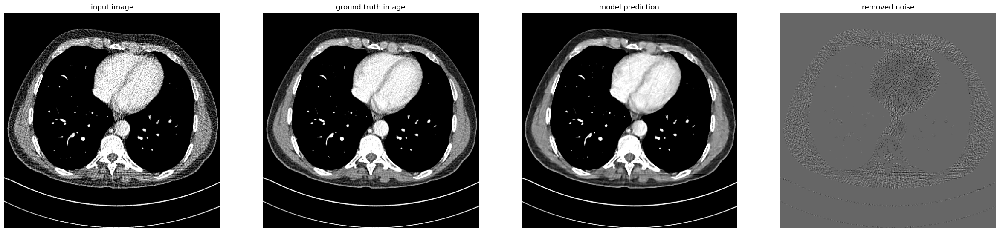

this image has start patches :  64
[Normalized Images (Range : 0.0 to 1.0)]
PSNR of reconsturcted image :  96.22981237884615
PSNR of noisy image :  92.27946996871042
SSIM of noisy image :  0.9999985920229842
SSIM of reconstructed image :  0.999999327419054
range of reconstructed image :  -160.0 240.0
range of clean image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
[After Denormalization]
PSNR of reconsturcted image :  28.02879203547817
PSNR of noisy image :  23.77072744405735
SSIM of noisy image :  0.8267089239980073
SSIM of reconstructed image :  0.8632161506907614


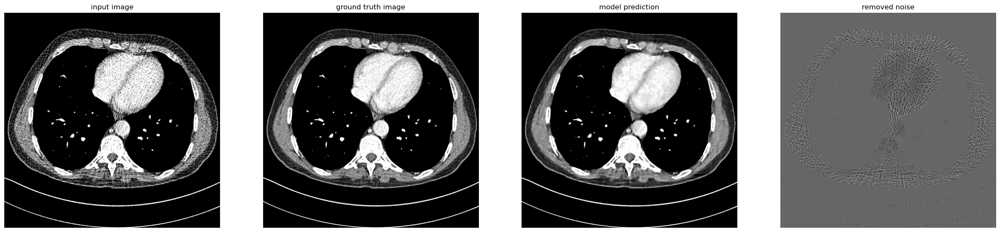

this image has start patches :  128
[Normalized Images (Range : 0.0 to 1.0)]
PSNR of reconsturcted image :  96.34687087836906
PSNR of noisy image :  92.40579016031317
SSIM of noisy image :  0.9999986203493323
SSIM of reconstructed image :  0.9999993418383307
range of reconstructed image :  -160.0 240.0
range of clean image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
[After Denormalization]
PSNR of reconsturcted image :  28.146211502779074
PSNR of noisy image :  23.872244369711602
SSIM of noisy image :  0.8266382269474193
SSIM of reconstructed image :  0.863527913239595


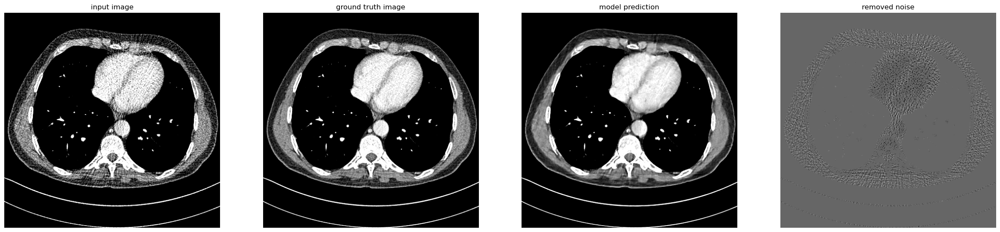

this image has start patches :  192
[Normalized Images (Range : 0.0 to 1.0)]
PSNR of reconsturcted image :  96.21333507928894
PSNR of noisy image :  92.22550792781591
SSIM of noisy image :  0.9999985729450727
SSIM of reconstructed image :  0.9999993233348337
range of reconstructed image :  -160.0 240.0
range of clean image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
[After Denormalization]
PSNR of reconsturcted image :  27.97910722311778
PSNR of noisy image :  23.68181948637809
SSIM of noisy image :  0.8239696552156925
SSIM of reconstructed image :  0.8618261942556776


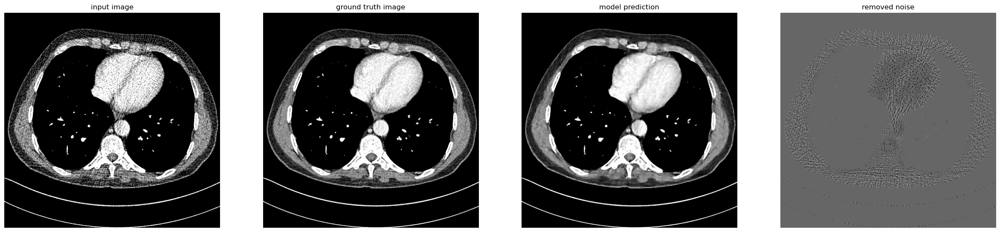

this image has start patches :  256
[Normalized Images (Range : 0.0 to 1.0)]
PSNR of reconsturcted image :  96.46442433609396
PSNR of noisy image :  92.49593098891867
SSIM of noisy image :  0.9999986529927045
SSIM of reconstructed image :  0.9999993526003438
range of reconstructed image :  -160.0 240.0
range of clean image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
[After Denormalization]
PSNR of reconsturcted image :  28.221519688307424
PSNR of noisy image :  23.979451548330296
SSIM of noisy image :  0.8293203755278982
SSIM of reconstructed image :  0.8660695771655047


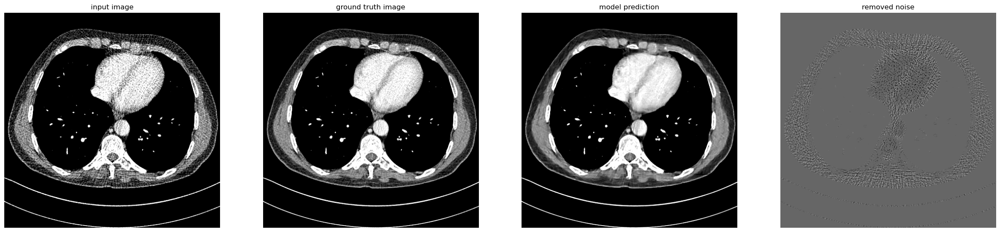

this image has start patches :  320
[Normalized Images (Range : 0.0 to 1.0)]
PSNR of reconsturcted image :  96.45965885289849
PSNR of noisy image :  92.63143924459132
SSIM of noisy image :  0.9999986921942106
SSIM of reconstructed image :  0.9999993515515248
range of reconstructed image :  -160.0 240.0
range of clean image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
[After Denormalization]
PSNR of reconsturcted image :  28.322428852577964
PSNR of noisy image :  24.178606306101663
SSIM of noisy image :  0.8309779759547119
SSIM of reconstructed image :  0.867436527834321


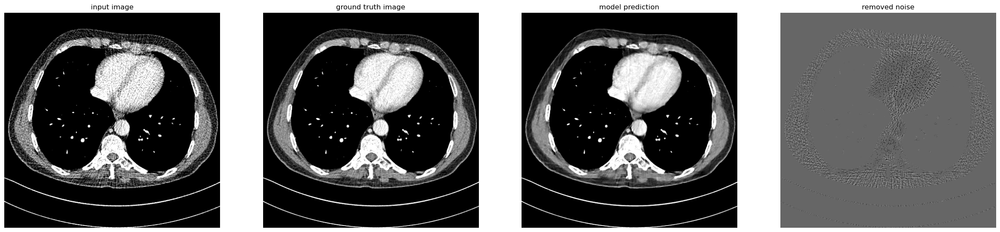

this image has start patches :  384
[Normalized Images (Range : 0.0 to 1.0)]
PSNR of reconsturcted image :  96.28786287441241
PSNR of noisy image :  92.33121061717192
SSIM of noisy image :  0.9999986148718211
SSIM of reconstructed image :  0.99999933264604
range of reconstructed image :  -160.0 240.0
range of clean image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
[After Denormalization]
PSNR of reconsturcted image :  28.202089400144345
PSNR of noisy image :  23.928403306314998
SSIM of noisy image :  0.8297214879196988
SSIM of reconstructed image :  0.86684708932182


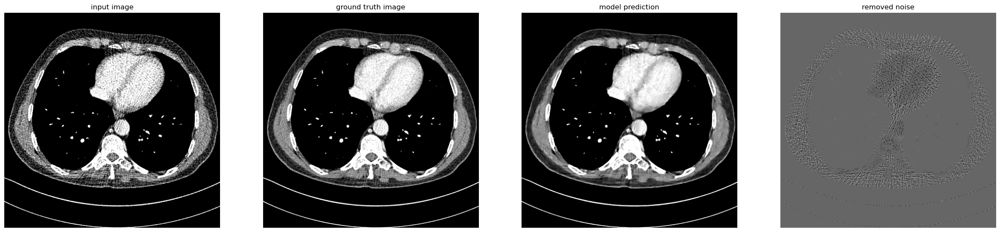

this image has start patches :  448
[Normalized Images (Range : 0.0 to 1.0)]
PSNR of reconsturcted image :  96.65974798740757
PSNR of noisy image :  92.7167126926897
SSIM of noisy image :  0.9999987217652953
SSIM of reconstructed image :  0.999999383682164
range of reconstructed image :  -160.0 240.0
range of clean image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
[After Denormalization]
PSNR of reconsturcted image :  28.383979503278724
PSNR of noisy image :  24.188060278312804
SSIM of noisy image :  0.8322187958433044
SSIM of reconstructed image :  0.8696186690621229


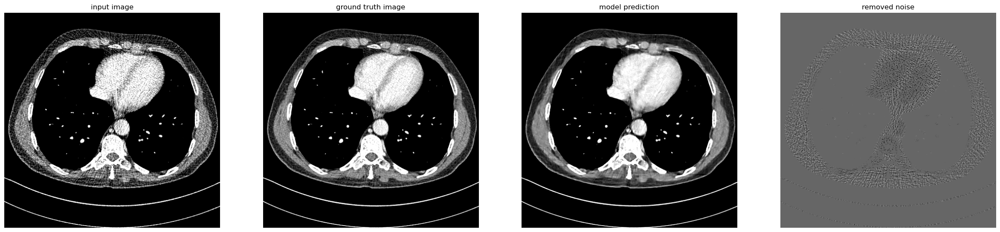

this image has start patches :  512
[Normalized Images (Range : 0.0 to 1.0)]
PSNR of reconsturcted image :  96.73806885897888
PSNR of noisy image :  92.81249212520486
SSIM of noisy image :  0.9999987602445192
SSIM of reconstructed image :  0.9999993977330799
range of reconstructed image :  -160.0 240.0
range of clean image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
[After Denormalization]
PSNR of reconsturcted image :  28.50988389293412
PSNR of noisy image :  24.267820089605138
SSIM of noisy image :  0.8321634393177689
SSIM of reconstructed image :  0.8699684849853886


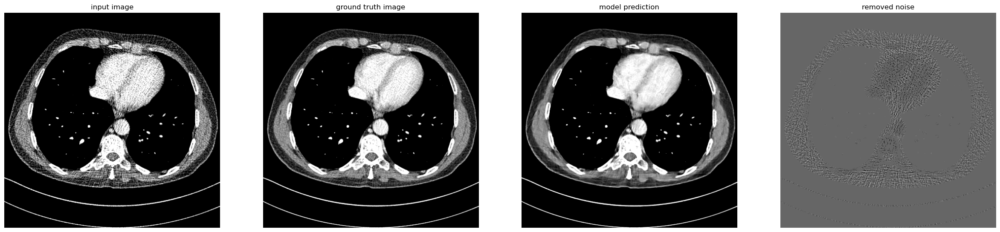

this image has start patches :  576
[Normalized Images (Range : 0.0 to 1.0)]
PSNR of reconsturcted image :  96.46387643564309
PSNR of noisy image :  92.5396147221831
SSIM of noisy image :  0.9999986762241032
SSIM of reconstructed image :  0.9999993580552666
range of reconstructed image :  -160.0 240.0
range of clean image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
[After Denormalization]
PSNR of reconsturcted image :  28.197562669130928
PSNR of noisy image :  24.01930346507163
SSIM of noisy image :  0.8314094636567702
SSIM of reconstructed image :  0.8683278597031878


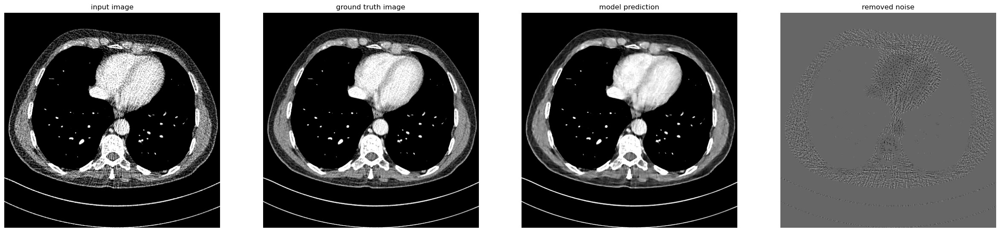

this image has start patches :  640
[Normalized Images (Range : 0.0 to 1.0)]
PSNR of reconsturcted image :  96.45372953649539
PSNR of noisy image :  92.31250782830597
SSIM of noisy image :  0.9999987072423344
SSIM of reconstructed image :  0.9999994461808938
range of reconstructed image :  -160.0 240.0
range of clean image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
[After Denormalization]
PSNR of reconsturcted image :  28.096095458984195
PSNR of noisy image :  23.769318678026554
SSIM of noisy image :  0.815310981844123
SSIM of reconstructed image :  0.8496830796685223


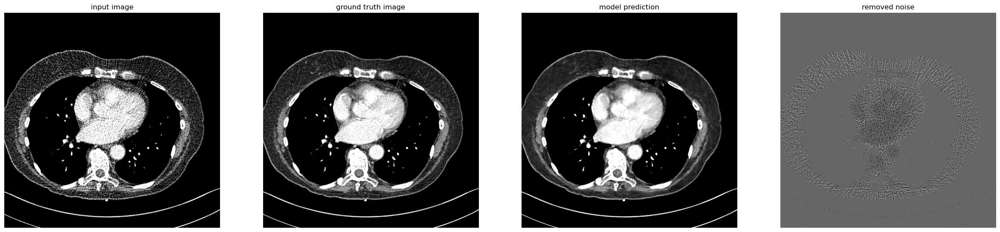

this image has start patches :  704
[Normalized Images (Range : 0.0 to 1.0)]
PSNR of reconsturcted image :  100.18604547428991
PSNR of noisy image :  95.39826221353476
SSIM of noisy image :  0.9999993759656831
SSIM of reconstructed image :  0.9999997407243468
range of reconstructed image :  -160.0 240.0
range of clean image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
[After Denormalization]
PSNR of reconsturcted image :  29.508914713383483
PSNR of noisy image :  24.65118878824463
SSIM of noisy image :  0.7623524272392914
SSIM of reconstructed image :  0.8153829965901472


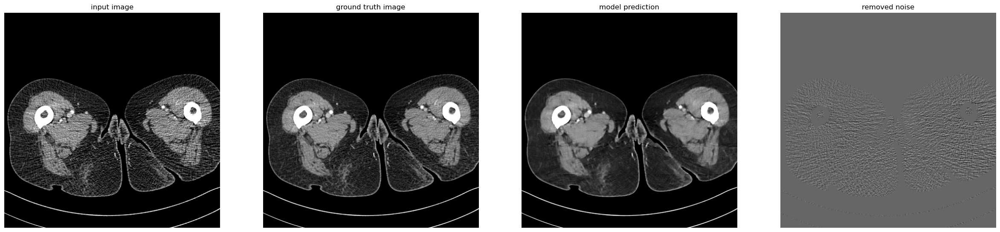

this image has start patches :  768
[Normalized Images (Range : 0.0 to 1.0)]
PSNR of reconsturcted image :  99.37902803124373
PSNR of noisy image :  94.69216938304895
SSIM of noisy image :  0.9999993075614857
SSIM of reconstructed image :  0.9999997244313091
range of reconstructed image :  -160.0 240.0
range of clean image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
[After Denormalization]
PSNR of reconsturcted image :  29.25426174463354
PSNR of noisy image :  24.506914598967775
SSIM of noisy image :  0.7943998853394736
SSIM of reconstructed image :  0.8333383611875582


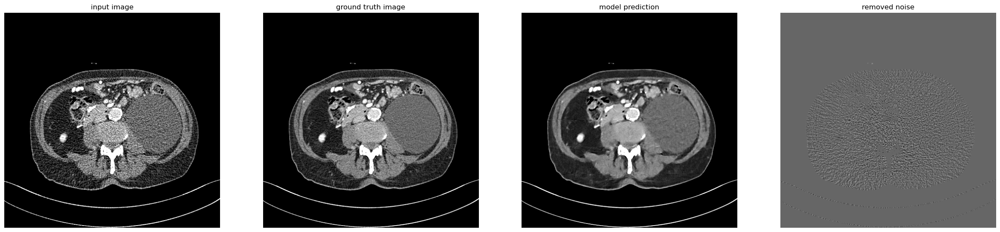

this image has start patches :  832
[Normalized Images (Range : 0.0 to 1.0)]
PSNR of reconsturcted image :  98.84404005013074
PSNR of noisy image :  94.12074139263535
SSIM of noisy image :  0.9999991038722521
SSIM of reconstructed image :  0.9999996725755136
range of reconstructed image :  -160.0 240.0
range of clean image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
[After Denormalization]
PSNR of reconsturcted image :  29.568708536692306
PSNR of noisy image :  24.71547001596449
SSIM of noisy image :  0.8488457257361408
SSIM of reconstructed image :  0.8771025725168393


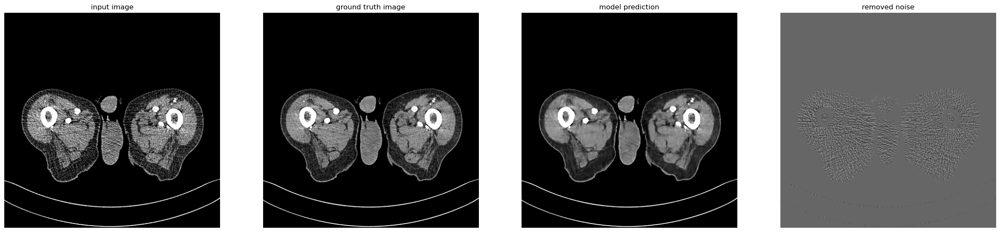







Model prediction test on blind images
10/10 [==============================] - 2s 168ms/step
datatype of patches :  float64
patches per image :  64
this image has start patches :  0
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  8.889291466012407
SSIM of reconstructed image :  0.549030332653787


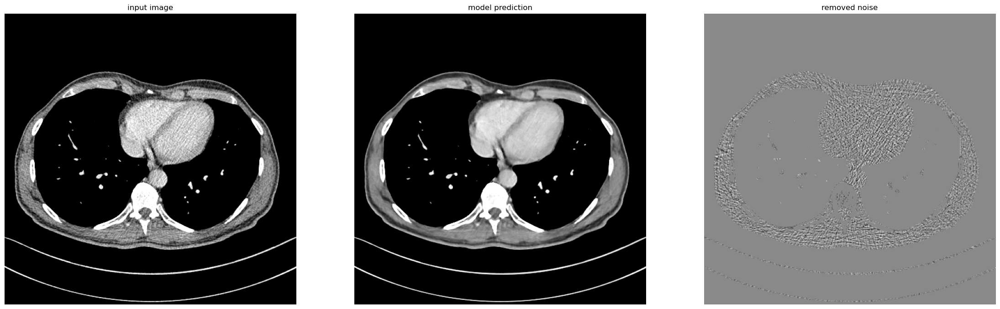

this image has start patches :  64
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  8.9006697405414
SSIM of reconstructed image :  0.5507423037822234


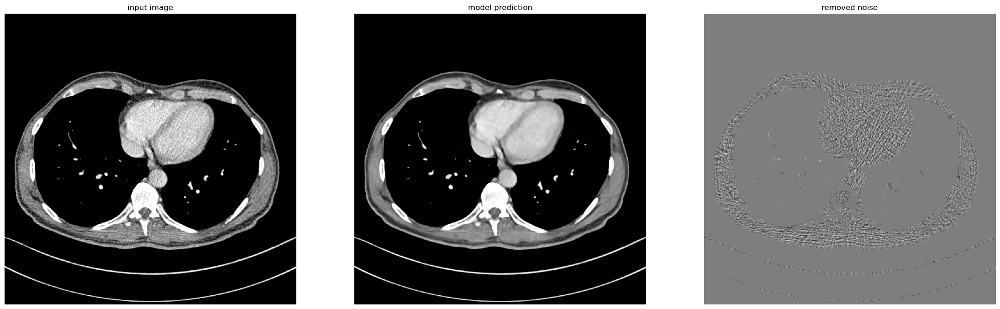

this image has start patches :  128
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  8.912525734978527
SSIM of reconstructed image :  0.5518227591025597


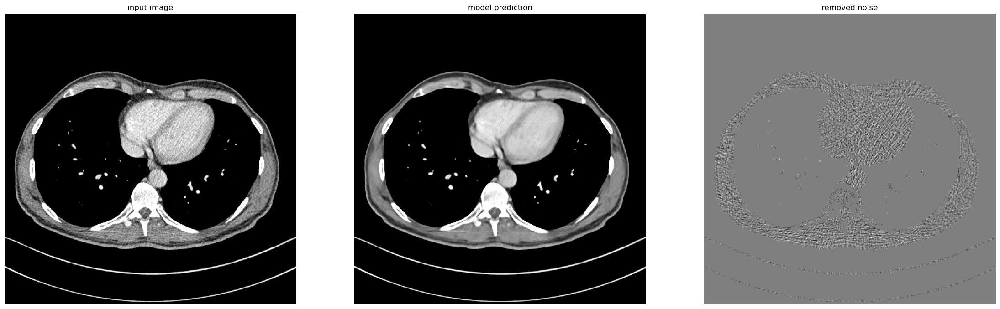

this image has start patches :  192
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  8.911083486708044
SSIM of reconstructed image :  0.5514706367759779


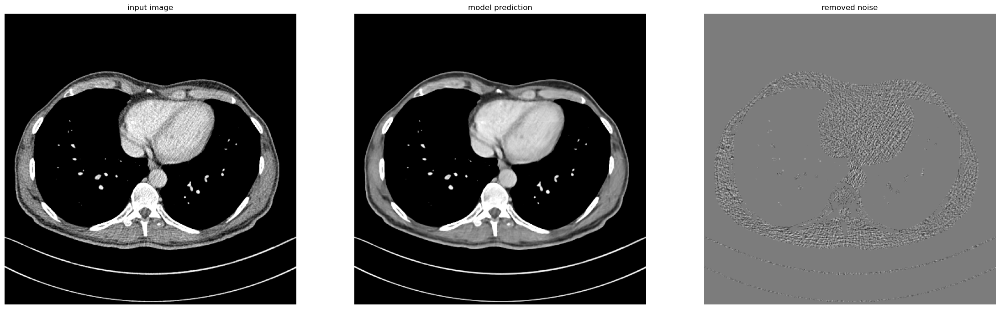

this image has start patches :  256
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  8.913524299693094
SSIM of reconstructed image :  0.5527168198378634


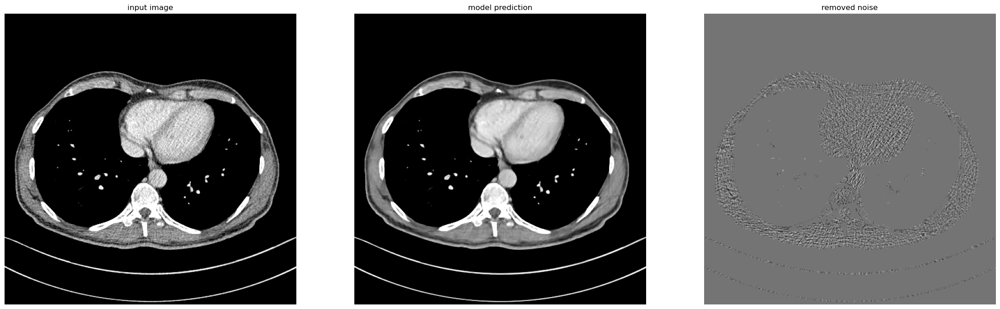

In [10]:
from hformer_model_extended import get_hformer_model

# Get model and build (required for loading weights).
model = get_hformer_model(num_channels_to_be_generated=64, name="hformer_model_extended_64_channel")
model.build(input_shape=(None, 64, 64, 1)) 
model.summary()

# We are required to set custom_objects since we are using custom loss function
loaded_model = model.load_weights('hformer_64_channel_custom_loss_epochs_48.h5')
history = np.load('../4000_image_data/4000_image_hformer_200_epoch_history_extended_64_channel_custom_loss.npy', allow_pickle=True).item()

evaluate_model(model, history, 'hformer_64_extended_partial_epoch', 'psnr_and_accuracy')

Test on small dataset with higher number of epochs

NOTE : The below cell is a workbench
Testing if per-epoch .h5 files are useful for testing purposes.
Currently using custom loss function (1 - SSIM) + MSE

In [11]:
from hformer_model_extended import get_hformer_model

# Get model and build (required for loading weights).
model = get_hformer_model(num_channels_to_be_generated=64, name="hformer_model_extended_64_channel")
model.build(input_shape=(None, 64, 64, 1)) 
model.summary()

# We are required to set custom_objects since we are using custom loss function
loaded_model = model.load_weights('../data/hformer_64_channel_custom_loss_epochs_33.h5')
history = np.load('../data/saved_weights_and_history/hformer_200_epoch_history_extended_64_channel_custom_loss.npy', allow_pickle=True).item()

evaluate_model(model, history, 'hformer_64_extended_partial_epoch', 'psnr')

Model: "hformer_model_extended_64_channel"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_projection_layer (Inp  multiple                 320       
 utProjectionLayer)                                              
                                                                 
 output_projection_layer (Ou  multiple                 257       
 tputProjectionLayer)                                            
                                                                 
 conv_net_block_1 (Convoluti  multiple                 36416     
 onBlock)                                                        
                                                                 
 conv_net_block_2 (Convoluti  multiple                 36416     
 onBlock)                                                        
                                                                 
 downsampling_layer_1 (Conv2  mul

FileNotFoundError: [Errno 2] Unable to synchronously open file (unable to open file: name = '../data/hformer_64_channel_custom_loss_epochs_33.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

Test with the 'Small' version of hformer (16 channels), ~61K learnable parameters

In [ ]:
# Get model and build (required for loading weights).
from hformer_model import get_hformer_model

model = get_hformer_model(num_channels_to_be_generated=16, name="hformer_model")
model.build(input_shape=(None, 64, 64, 1)) 
model.summary()

# We are required to set custom_objects since we are using custom loss function
loaded_model = model.load_weights('saved_weights_and_history/hformer_25_epoch_16_channel_full_dataset.h5')
history = np.load('saved_weights_and_history/hformer_25_epoch_16_channel_full_datasethistory.npy', allow_pickle=True).item()

evaluate_model(model, history, 'hformer_16_channel_small', 'accuracy')

Model: "hformer_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_projection_layer (Inp  multiple                 160       
 utProjectionLayer)                                              
                                                                 
 output_projection_layer (Ou  multiple                 145       
 tputProjectionLayer)                                            
                                                                 
 conv_net_block_1 (Convoluti  multiple                 1376      
 onBlock)                                                        
                                                                 
 conv_net_block_2 (Convoluti  multiple                 1376      
 onBlock)                                                        
                                                                 
 downsampling_layer_1 (Conv2  multiple               

FileNotFoundError: [Errno 2] Unable to synchronously open file (unable to open file: name = 'saved_weights_and_history/hformer_25_epoch_16_channel_full_dataset.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

Evaluation of Hformer extended Medium (48 channel), ~850K learnable parameters

Model: "hformer_model_extended_48_channel"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_projection_layer (Inp  multiple                 240       
 utProjectionLayer)                                              
                                                                 
 output_projection_layer (Ou  multiple                 193       
 tputProjectionLayer)                                            
                                                                 
 conv_net_block_1 (Convoluti  multiple                 21168     
 onBlock)                                                        
                                                                 
 conv_net_block_2 (Convoluti  multiple                 21168     
 onBlock)                                                        
                                                                 
 downsampling_layer_1 (Conv2  mul

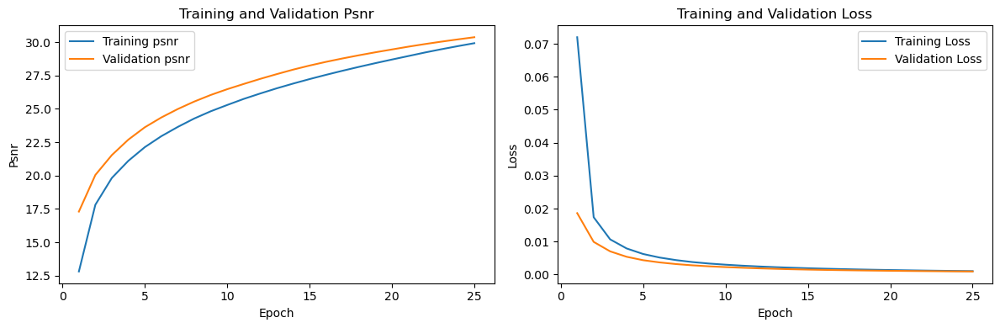

Model prediction test
20/20 [==============================] - 3s 91ms/step
patches per image :  64
datatype of patches :  float32
this image has start patches :  0
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.235756483701817
PSNR of noisy image :  23.485824280503806
SSIM of noisy image :  0.8430164
SSIM of reconstructed image :  0.71327984


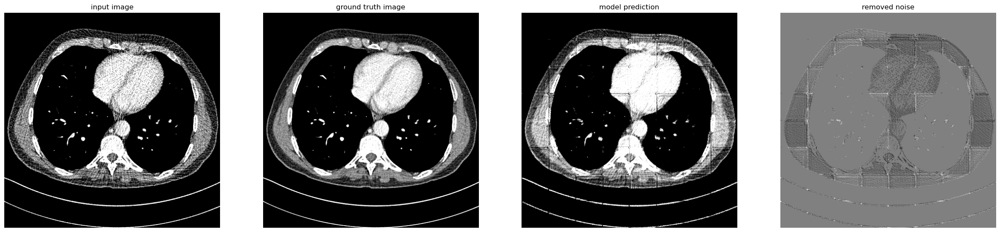

this image has start patches :  64
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.268418666770632
PSNR of noisy image :  23.77072744405735
SSIM of noisy image :  0.8466024
SSIM of reconstructed image :  0.71343815


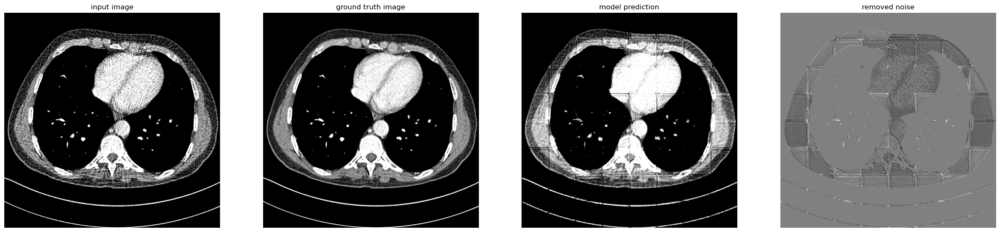

this image has start patches :  128
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.308942377414958
PSNR of noisy image :  23.872244369711602
SSIM of noisy image :  0.84596694
SSIM of reconstructed image :  0.71472937


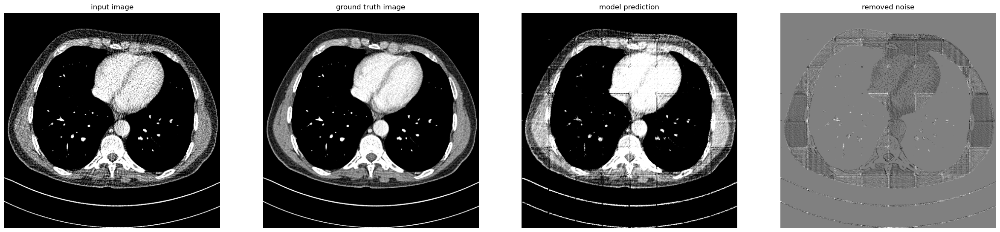

this image has start patches :  192
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.298364595520454
PSNR of noisy image :  23.68181948637809
SSIM of noisy image :  0.84348005
SSIM of reconstructed image :  0.71332425


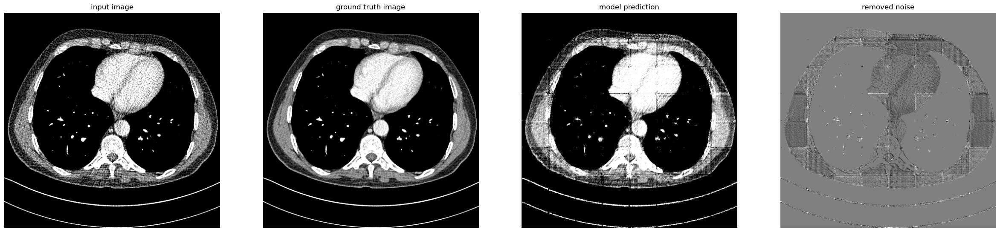

this image has start patches :  256
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.32543163936341
PSNR of noisy image :  23.979451548330296
SSIM of noisy image :  0.8488928
SSIM of reconstructed image :  0.71431583


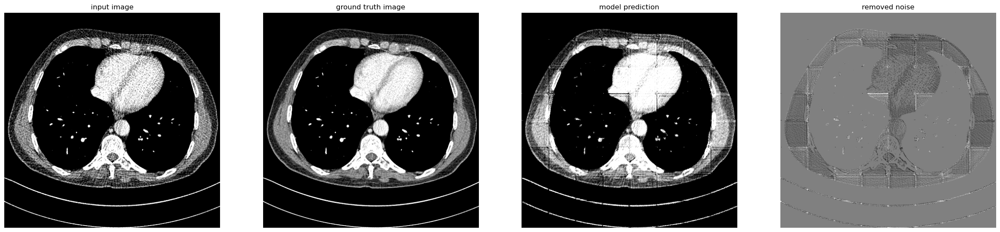

this image has start patches :  320
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.389541460448832
PSNR of noisy image :  24.178606306101663
SSIM of noisy image :  0.8512244
SSIM of reconstructed image :  0.717687


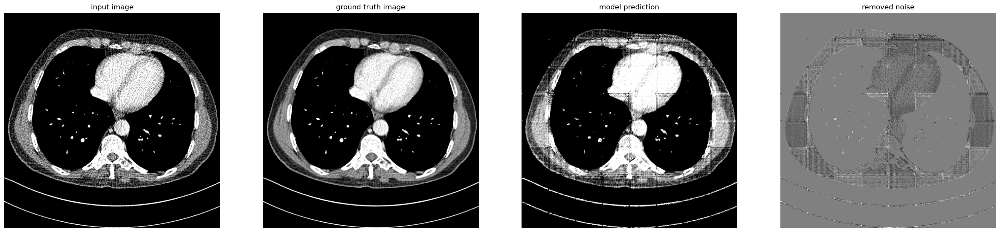

this image has start patches :  384
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.364829935020186
PSNR of noisy image :  23.928403306314998
SSIM of noisy image :  0.8495585
SSIM of reconstructed image :  0.7178187


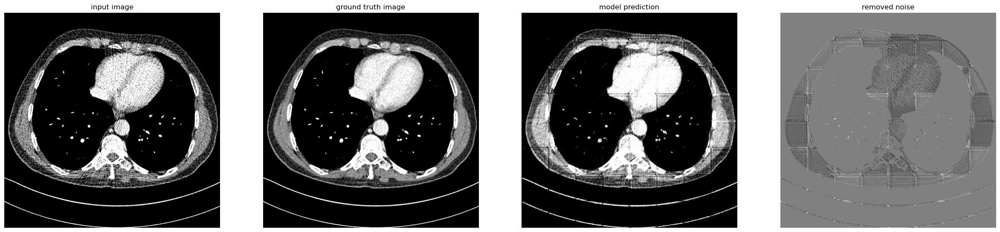

this image has start patches :  448
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.42125286217108
PSNR of noisy image :  24.188060278312804
SSIM of noisy image :  0.85253966
SSIM of reconstructed image :  0.71890247


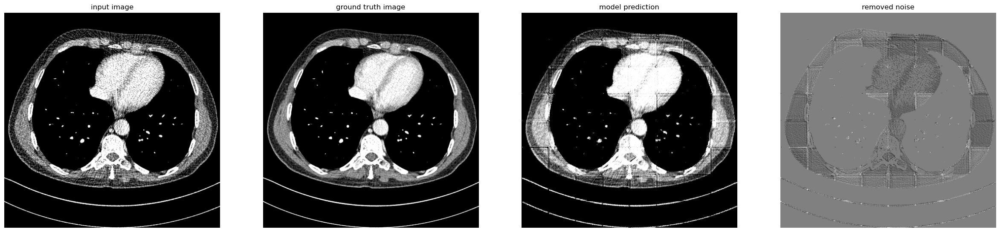

this image has start patches :  512
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.453580416266043
PSNR of noisy image :  24.267820089605138
SSIM of noisy image :  0.85317534
SSIM of reconstructed image :  0.71905255


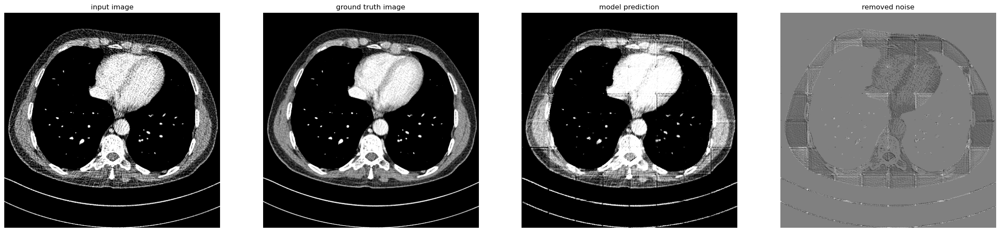

this image has start patches :  576
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.447965989383473
PSNR of noisy image :  24.01930346507163
SSIM of noisy image :  0.8521291
SSIM of reconstructed image :  0.7177456


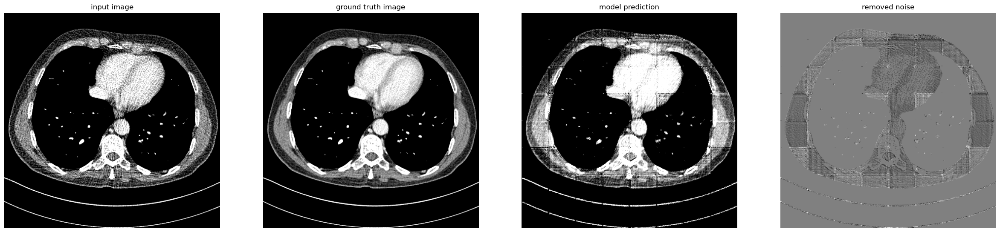







Model prediction test on blind images
10/10 [==============================] - 1s 121ms/step
datatype of patches :  float32
patches per image :  64
this image has start patches :  0
range of reconstructed image :  -0.16484083235263824 0.6340979933738708
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  10.219642693066156
SSIM of reconstructed image :  0.51080257


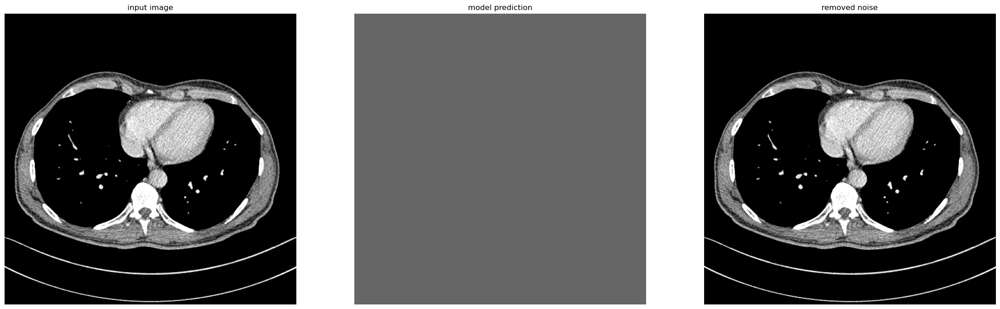

this image has start patches :  64
range of reconstructed image :  -0.16914743185043335 0.6401082277297974
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  10.238377958335775
SSIM of reconstructed image :  0.5122707


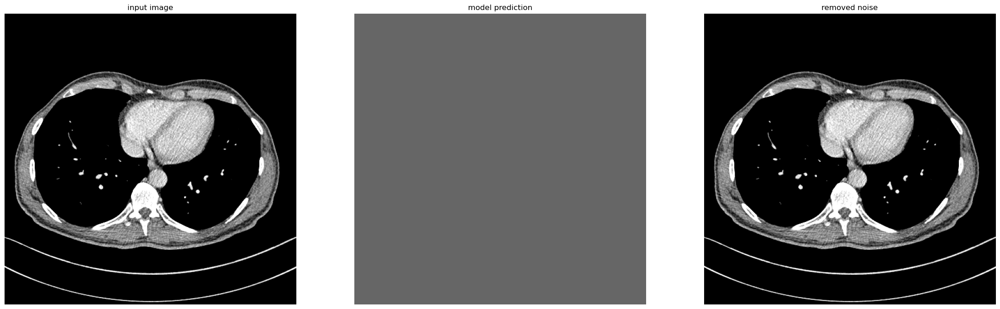

this image has start patches :  128
range of reconstructed image :  -0.170680433511734 0.621779203414917
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  10.24576294803227
SSIM of reconstructed image :  0.5132808


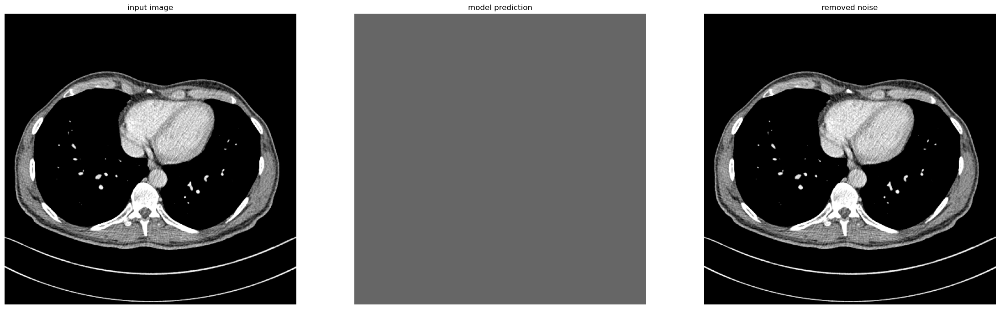

this image has start patches :  192
range of reconstructed image :  -0.16130197048187256 0.605466365814209
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  10.25293788915311
SSIM of reconstructed image :  0.5151552


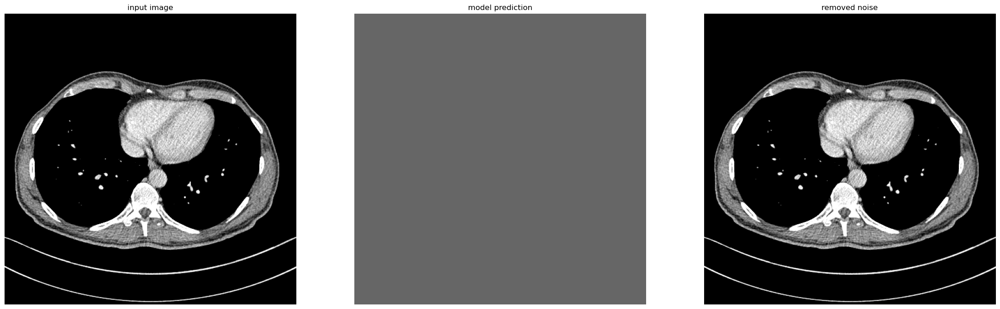

this image has start patches :  256
range of reconstructed image :  -0.16326045989990234 0.6053165197372437
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  10.280614623478678
SSIM of reconstructed image :  0.51607436


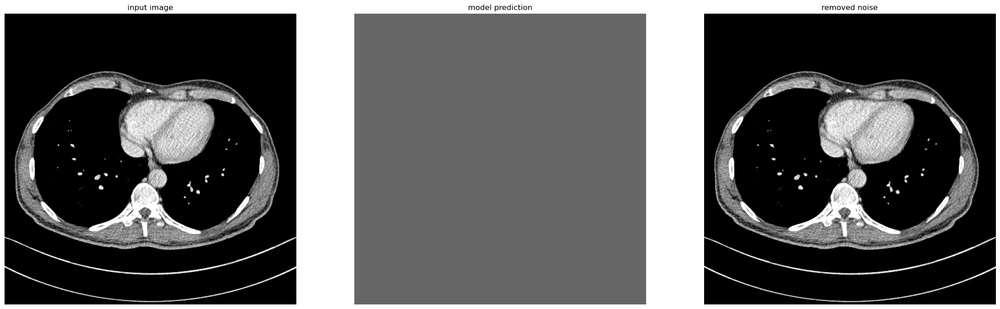

In [ ]:
from hformer_model_extended import get_hformer_model

# Get model and build (required for loading weights).
model = get_hformer_model(num_channels_to_be_generated=48, name="hformer_model_extended_48_channel")
model.build(input_shape=(None, 64, 64, 1)) 
model.summary()

# We are required to set custom_objects since we are using custom loss function
loaded_model = model.load_weights('saved_weights_and_history/hformer_25_epoch_extended_48_channel.h5')
history = np.load('saved_weights_and_history/hformer_25_epoch_history_extended_48_channel.npy', allow_pickle=True).item()

evaluate_model(model, history, 'hformer_48_channel_medium_extended', 'psnr')

Test with hformer medium 30 epoch (~850K parameters but using accuracy as metric instead of PSNR)

Model: "hformer_model_extended_48_channel"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_projection_layer (Inp  multiple                 240       
 utProjectionLayer)                                              
                                                                 
 output_projection_layer (Ou  multiple                 193       
 tputProjectionLayer)                                            
                                                                 
 conv_net_block_1 (Convoluti  multiple                 21168     
 onBlock)                                                        
                                                                 
 conv_net_block_2 (Convoluti  multiple                 21168     
 onBlock)                                                        
                                                                 
 downsampling_layer_1 (Conv2  mul

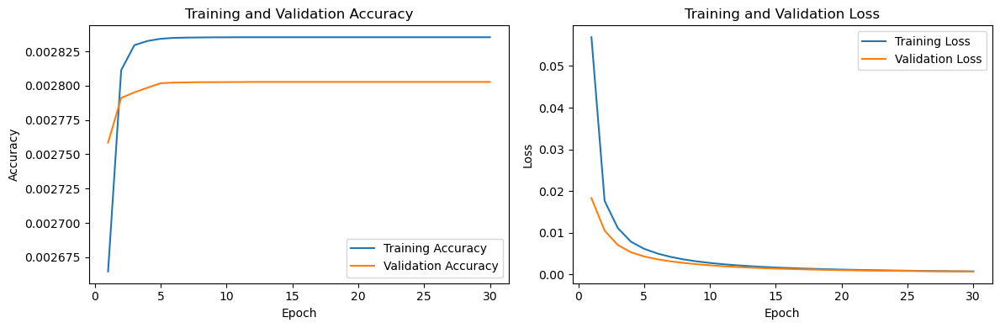

Model prediction test
18/20 [==========================>...] - ETA: 0s

KeyboardInterrupt: 

In [ ]:
from hformer_model_extended import get_hformer_model

# Get model and build (required for loading weights).
model = get_hformer_model(num_channels_to_be_generated=48, name="hformer_model_extended_48_channel")
model.build(input_shape=(None, 64, 64, 1)) 
model.summary()

# We are required to set custom_objects since we are using custom loss function
loaded_model = model.load_weights('saved_weights_and_history/hformer_30_epoch_extended_48_channel.h5')
history = np.load('saved_weights_and_history/hformer_30_epoch_history_extended_48_channel.npy', allow_pickle=True).item()

evaluate_model(model, history, 'hformer_48_channel_medium_extended', 'accuracy')

Test with hformer large 40 epoch (~1.5M parameters, trained on full dataset with psnr as metric)

Model: "hformer_model_extended_64_channel"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_projection_layer (Inp  multiple                 320       
 utProjectionLayer)                                              
                                                                 
 output_projection_layer (Ou  multiple                 257       
 tputProjectionLayer)                                            
                                                                 
 conv_net_block_1 (Convoluti  multiple                 36416     
 onBlock)                                                        
                                                                 
 conv_net_block_2 (Convoluti  multiple                 36416     
 onBlock)                                                        
                                                                 
 downsampling_layer_1 (Conv2  mul

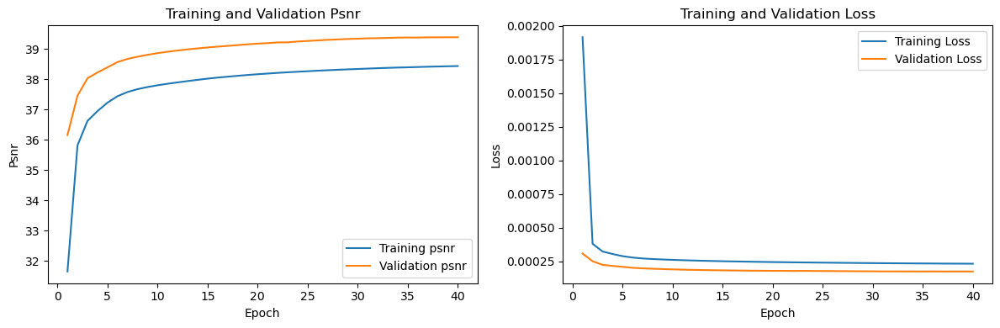

Model prediction test
20/20 [==============================] - 4s 165ms/step
patches per image :  64
datatype of patches :  float32
this image has start patches :  0
range of reconstructed image :  -0.006666586268693209 0.8740199208259583
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  38.97019028915183
PSNR of noisy image :  35.600297920932945
SSIM of noisy image :  0.8751545
SSIM of reconstructed image :  0.9383967


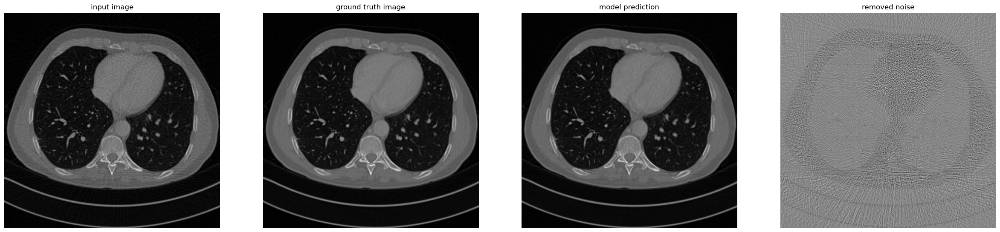

this image has start patches :  64
range of reconstructed image :  -0.0036330311559140682 0.8915669322013855
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  39.177857976811175
PSNR of noisy image :  35.84850443503983
SSIM of noisy image :  0.88206375
SSIM of reconstructed image :  0.94147146


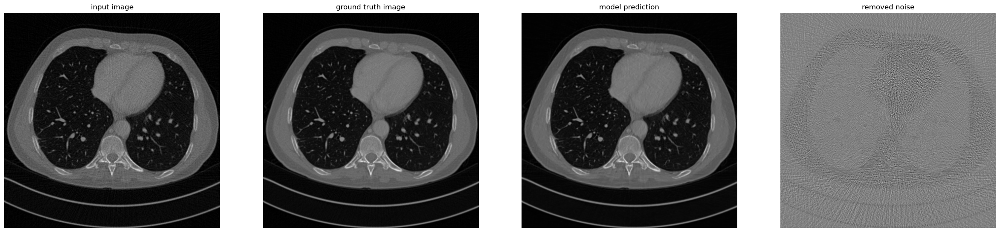

this image has start patches :  128
range of reconstructed image :  -0.004642984364181757 0.8601873517036438
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  39.26846390031074
PSNR of noisy image :  35.94381337057423
SSIM of noisy image :  0.88362473
SSIM of reconstructed image :  0.94244415


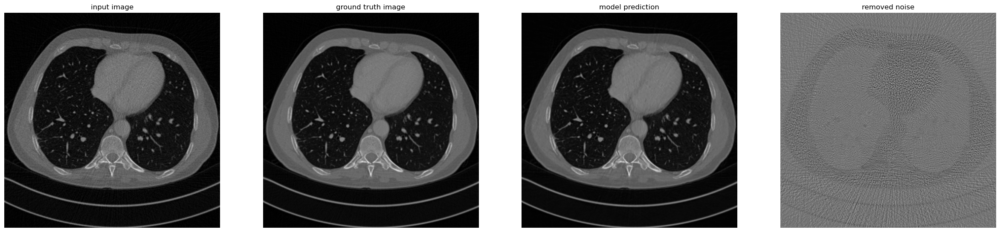

this image has start patches :  192
range of reconstructed image :  -0.005993845406919718 0.9049400687217712
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  39.16206805809752
PSNR of noisy image :  35.80295137061293
SSIM of noisy image :  0.8803377
SSIM of reconstructed image :  0.9410616


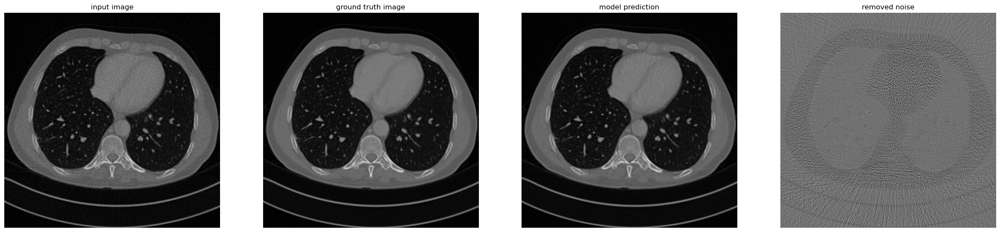

this image has start patches :  256
range of reconstructed image :  -0.00552479038015008 0.9052478671073914
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  39.4142381178311
PSNR of noisy image :  36.031714880289194
SSIM of noisy image :  0.8857574
SSIM of reconstructed image :  0.9444214


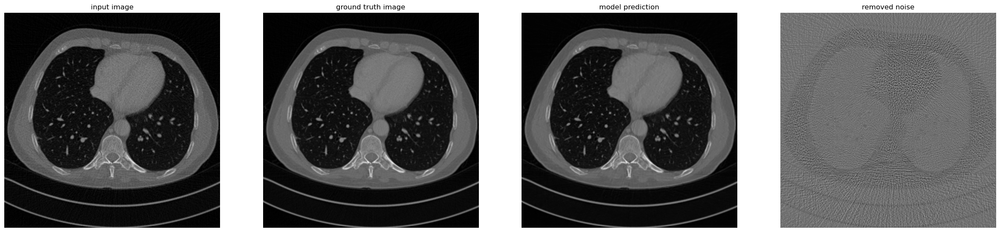

this image has start patches :  320
range of reconstructed image :  -0.0033871536143124104 0.9254003763198853
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  39.466817803996015
PSNR of noisy image :  36.14461720214498
SSIM of noisy image :  0.8884423
SSIM of reconstructed image :  0.945187


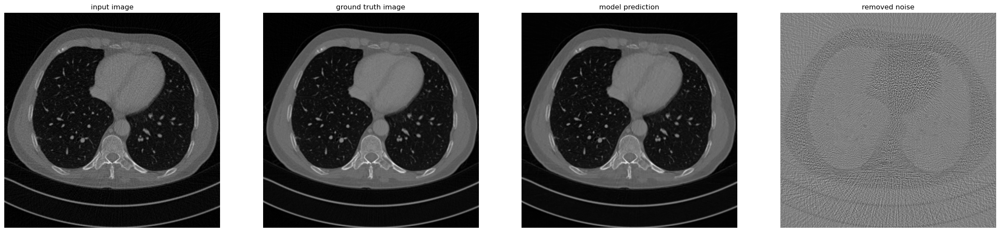

this image has start patches :  384
range of reconstructed image :  -0.003868765663355589 0.971359133720398
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  39.282609803403226
PSNR of noisy image :  35.89484727398816
SSIM of noisy image :  0.88258916
SSIM of reconstructed image :  0.9427929


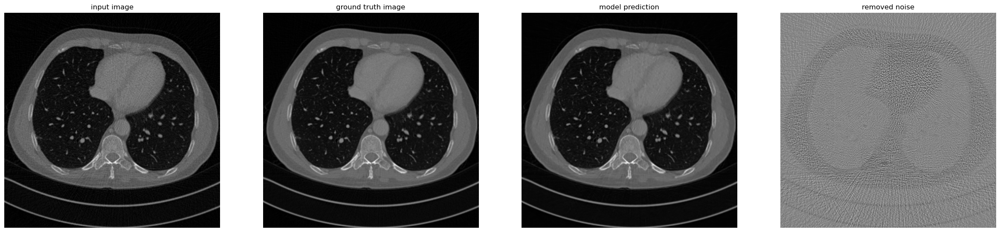

this image has start patches :  448
range of reconstructed image :  -0.0026800567284226418 0.9758231043815613
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  39.622552902215034
PSNR of noisy image :  36.22792618702719
SSIM of noisy image :  0.8901621
SSIM of reconstructed image :  0.94658095


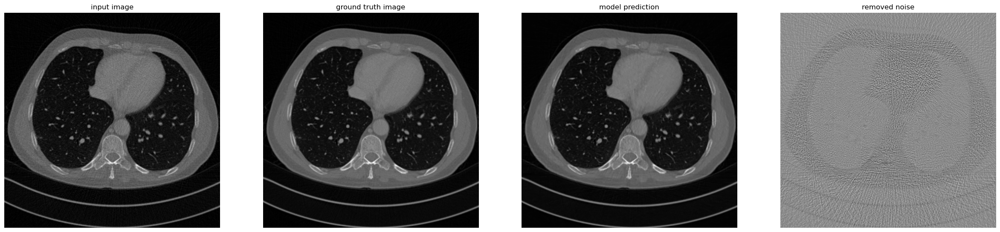

this image has start patches :  512
range of reconstructed image :  -0.0031045391224324703 0.9737979173660278
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  39.74555475045362
PSNR of noisy image :  36.32200486139171
SSIM of noisy image :  0.8920069
SSIM of reconstructed image :  0.94773346


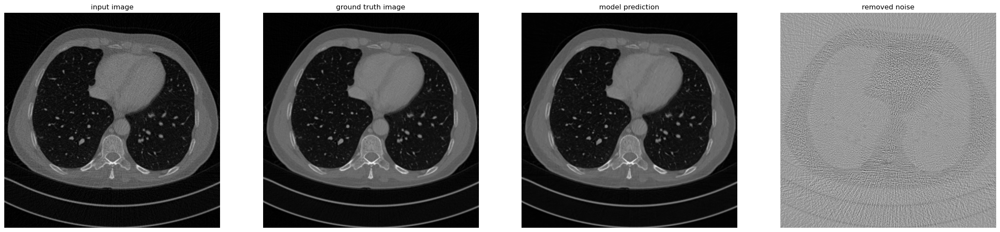

this image has start patches :  576
range of reconstructed image :  -0.0022748433984816074 1.0181899070739746
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  39.45713313477166
PSNR of noisy image :  36.09872754437181
SSIM of noisy image :  0.88726133
SSIM of reconstructed image :  0.94424784


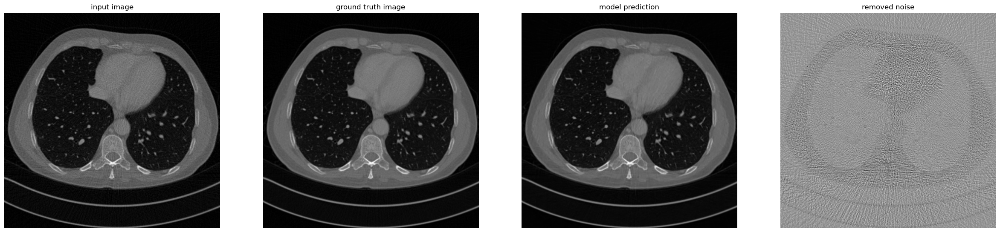







Model prediction test on blind images
10/10 [==============================] - 2s 168ms/step
datatype of patches :  float32
patches per image :  64
this image has start patches :  0
range of reconstructed image :  -0.006150650326162577 0.9948084354400635
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  15.06926513110743
SSIM of reconstructed image :  0.4959347


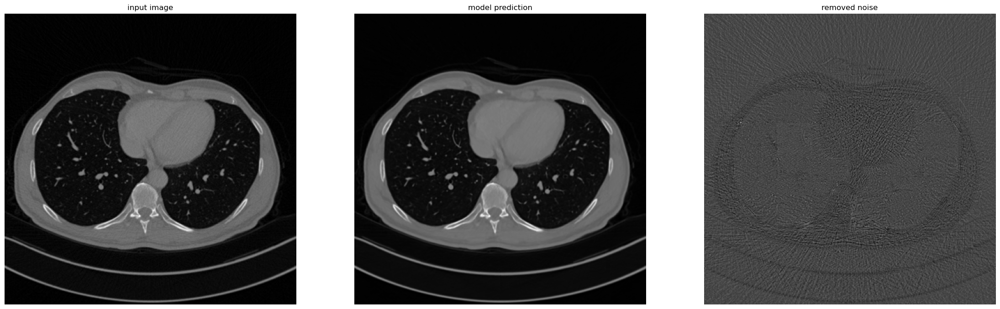

this image has start patches :  64
range of reconstructed image :  -0.006813067477196455 0.9875390529632568
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  15.086333938256878
SSIM of reconstructed image :  0.49761832


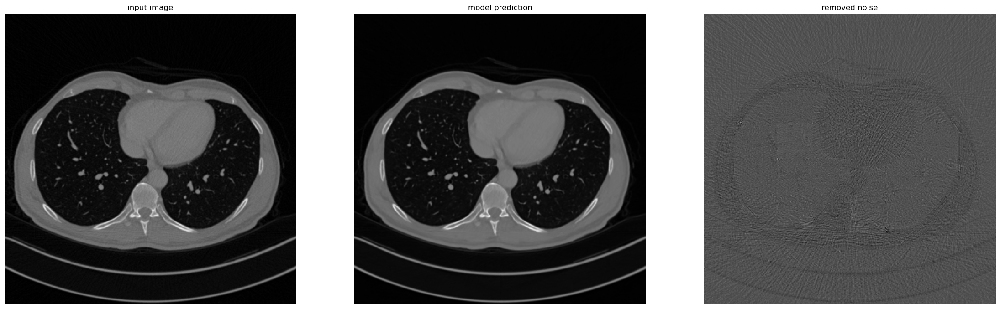

this image has start patches :  128
range of reconstructed image :  -0.006934926379472017 0.9839860200881958
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  15.092153060518665
SSIM of reconstructed image :  0.49783558


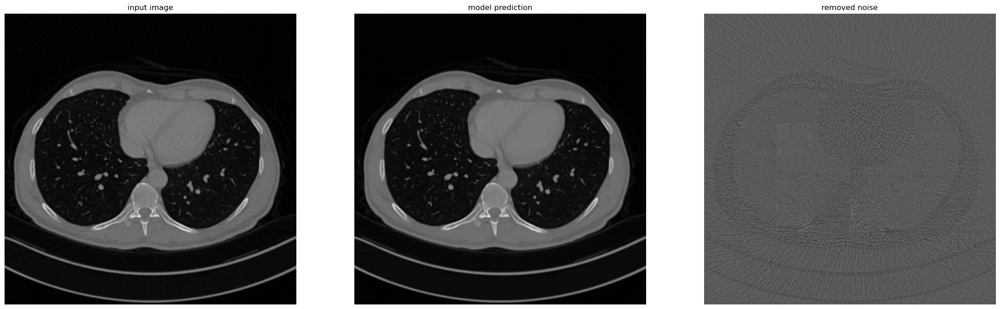

this image has start patches :  192
range of reconstructed image :  -0.005870324093848467 0.95383620262146
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  15.094518300425184
SSIM of reconstructed image :  0.49637288


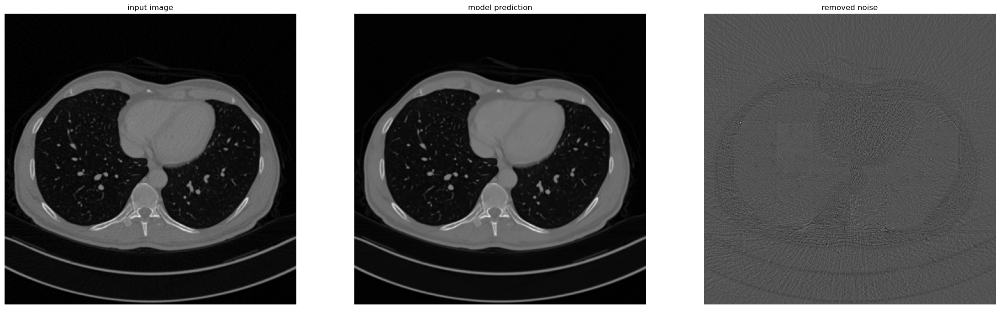

this image has start patches :  256
range of reconstructed image :  -0.003989348653703928 0.9444707632064819
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  15.105736488334053
SSIM of reconstructed image :  0.49771062


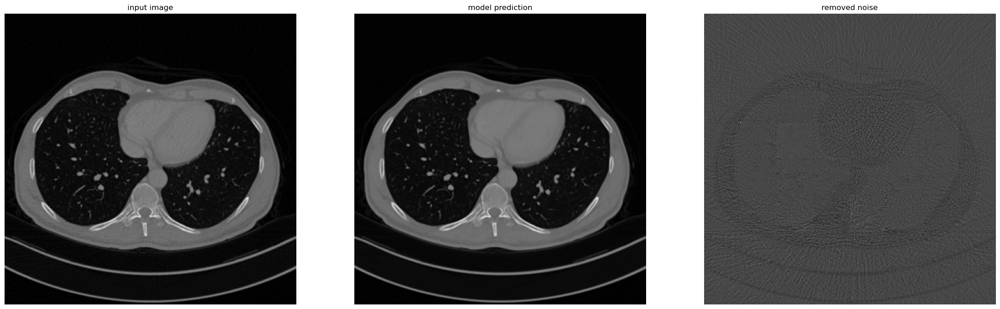

In [ ]:
from hformer_model_extended import get_hformer_model

# Get model and build (required for loading weights).
model = get_hformer_model(num_channels_to_be_generated=64, name="hformer_model_extended_64_channel")
model.build(input_shape=(None, 64, 64, 1)) 
model.summary()

# We are required to set custom_objects since we are using custom loss function
loaded_model = model.load_weights('saved_weights_and_history/hformer_40_epoch_extended_64_channel.h5')
history = np.load('saved_weights_and_history/hformer_40_epoch_history_extended_64_channel.npy', allow_pickle=True).item()

evaluate_model(model, history, 'hformer_48_channel_medium_extended', 'psnr')